<a href="https://colab.research.google.com/github/Joonqi/GCAD/blob/main/test_LOCO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Source
# '''
# https://github.com/denguir/student-teacher-anomaly-detection
# https://github.com/erezposner/Fast_Dense_Feature_Extraction
# https://discuss.pytorch.org/t/unet-implementation/426
# '''

In [ ]:
# !pip install einops
# !pip install torchsummary

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import torch
import torch.nn as nn
from torch.utils.data.dataloader import DataLoader
from torchvision import transforms
import torchvision.models as models
import numpy as np
import pandas as pd
from torchsummary import summary
# import pytorch_lightning as pl
from tqdm import tqdm
import PIL
from PIL import Image
import torchvision
from einops import reduce, rearrange
import pandas as pd


import warnings
warnings.filterwarnings(action='ignore')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
target_dataset = 'juice_bottle'
gen_code = '71389466'
PATH = f'/content/drive/MyDrive/LOCO_AD/{target_dataset}_{gen_code}_locUnet'
if os.path.exists(PATH):
    print(PATH)
else:
    raise Exception(f"No File_{target_dataset}")
    
    
target_dataset = 'breakfast_box'
gen_code = '71336023'
PATH = f'/content/drive/MyDrive/LOCO_AD/{target_dataset}_{gen_code}_locUnet'
if os.path.exists(PATH):
    print(PATH)
else:
    raise Exception(f"No File_{target_dataset}")
    
target_dataset = 'screw_bag'
gen_code = '71284081'
PATH = f'/content/drive/MyDrive/LOCO_AD/{target_dataset}_{gen_code}_locUnet'
if os.path.exists(PATH):
    print(PATH)
else:
    raise Exception(f"No File_{target_dataset}")
    

target_dataset = 'pushpins'
gen_code = '71230866'
PATH = f'/content/drive/MyDrive/LOCO_AD/{target_dataset}_{gen_code}_locUnet'
if os.path.exists(PATH):
    print(PATH)
else:
    raise Exception(f"No File_{target_dataset}")
    

target_dataset = 'splicing_connectors'
gen_code = '71179285'
if os.path.exists(PATH):
    print(PATH)
else:
    raise Exception(f"No File_{target_dataset}")


/content/drive/MyDrive/LOCO_AD/juice_bottle_71389466_locUnet
/content/drive/MyDrive/LOCO_AD/breakfast_box_71336023_locUnet
/content/drive/MyDrive/LOCO_AD/screw_bag_71284081_locUnet
/content/drive/MyDrive/LOCO_AD/pushpins_71230866_locUnet
/content/drive/MyDrive/LOCO_AD/pushpins_71230866_locUnet


In [ ]:
# use geometric augmentation flip for 'pushpins', 'splicing_connectors', 'screw_bag'

target_dataset = 'juice_bottle'
gen_code = '71389466'
PATH = f'/content/drive/MyDrive/LOCO_AD/{target_dataset}_{gen_code}_locUnet'

d_glo = 10
d_loc = 512


# os.makedirs(PATH, exist_ok=True)
# os.makedirs(PATH + '/results', exist_ok=True)
# for mode in ['both', 'global', 'local']:
#     os.makedirs(PATH + f'/results/{mode}', exist_ok=True)
    
if os.path.exists(PATH):
    print(PATH)
else:
    raise Exception("No File")

mode = 'both'
assert (mode in ['both', 'local', 'global'])

/content/drive/MyDrive/LOCO_AD/juice_bottle_71389466_locUnet


In [ ]:
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"  # Arrange GPU devices starting from 0
os.environ["CUDA_VISIBLE_DEVICES"]= "0,1"
os.environ["CUDA_LAUNCH_BLOCKING"]= '1'

In [ ]:
# Source:
# https://github.com/erezposner/Fast_Dense_Feature_Extraction

from torch import nn
import torch
import numpy as np
import torch.nn.functional as F

# (N,C,H,W)


class multiPoolPrepare(nn.Module):
    def __init__(self, patchY, patchX):
        super(multiPoolPrepare, self).__init__()
        pady = patchY - 1
        padx = patchX - 1

        self.pad_top = np.ceil(pady / 2).astype(int)
        self.pad_bottom = np.floor(pady / 2).astype(int)
        self.pad_left = np.ceil(padx / 2).astype(int)
        self.pad_right = np.floor(padx / 2).astype(int)

    def forward(self, x):
        y = F.pad(x, [self.pad_left, self.pad_right, self.pad_top, self.pad_bottom], value=0)
        return y


class unwrapPrepare(nn.Module):
    def __init__(self):
        super(unwrapPrepare, self).__init__()

    def forward(self, x):
        x_ = F.pad(x, [0, -1, 0, -1], value=0)
        y = x_.contiguous().view(x_.shape[0], -1)
        y = y.transpose(0, 1)
        return y.contiguous()


class unwrapPool(nn.Module):
    def __init__(self, outChans, curImgW, curImgH, dW, dH):
        super(unwrapPool, self).__init__()
        self.outChans = int(outChans)
        self.curImgW = int(curImgW)
        self.curImgH = int(curImgH)
        self.dW = int(dW)
        self.dH = int(dH)

    def forward(self, x, ):
        y = x.view((self.outChans, self.curImgW, self.curImgH, self.dH, self.dW, -1))
        y = y.transpose(2, 3)

        return y.contiguous()


class multiMaxPooling(nn.Module):
    def __init__(self, kW, kH, dW, dH):
        super(multiMaxPooling, self).__init__()
        layers = []
        self.padd = []
        for i in range(0, dH):
            for j in range(0, dW):
                self.padd.append((-j, -i))
                layers.append(nn.MaxPool2d(kernel_size=(kW, kH), stride=(dW, dH)))
        self.max_layers = nn.ModuleList(layers)
        self.s = dH

    def forward(self, x):

        hh = []
        ww = []
        res = []

        for i in range(0, len(self.max_layers)):
            pad_left, pad_top = self.padd[i]
            _x = F.pad(x, [pad_left, pad_left, pad_top, pad_top], value=0)
            _x = self.max_layers[i](_x)
            h, w = _x.size()[2], _x.size()[3]
            hh.append(h)
            ww.append(w)
            res.append(_x)
        max_h, max_w = np.max(hh), np.max(ww)
        for i in range(0, len(self.max_layers)):
            _x = res[i]
            h, w = _x.size()[2], _x.size()[3]
            pad_top = np.floor((max_h - h) / 2).astype(int)
            pad_bottom = np.ceil((max_h - h) / 2).astype(int)
            pad_left = np.floor((max_w - w) / 2).astype(int)
            pad_right = np.ceil((max_w - w) / 2).astype(int)
            _x = F.pad(_x, [pad_left, pad_right, pad_top, pad_bottom], value=0)
            res[i] = _x
        return torch.cat(res, 0)


class multiConv(nn.Module):
    def __init__(self, nInputPlane, nOutputPlane, kW, kH, dW, dH):
        super(multiConv, self).__init__()
        layers = []
        self.padd = []
        for i in range(0, dH):
            for j in range(0, dW):
                self.padd.append((-j, -i))
                torch.manual_seed(10)
                torch.cuda.manual_seed(10)
                a = nn.Conv2d(nInputPlane, nOutputPlane, kernel_size=(kW, kH), stride=(dW, dH), padding=0)
                layers.append(a)
        self.max_layers = nn.ModuleList(layers)
        self.s = dW

    def forward(self, x):
        hh = []
        ww = []
        res = []

        for i in range(0, len(self.max_layers)):
            pad_left, pad_top = self.padd[i]
            _x = F.pad(x, [pad_left, pad_left, pad_top, pad_top], value=0)
            _x = self.max_layers[i](_x)
            h, w = _x.size()[2], _x.size()[3]
            hh.append(h)
            ww.append(w)
            res.append(_x)
        max_h, max_w = np.max(hh), np.max(ww)
        for i in range(0, len(self.max_layers)):
            _x = res[i]
            h, w = _x.size()[2], _x.size()[3]
            pad_top = np.ceil((max_h - h) / 2).astype(int)
            pad_bottom = np.floor((max_h - h) / 2).astype(int)
            pad_left = np.ceil((max_w - w) / 2).astype(int)
            pad_right = np.floor((max_w - w) / 2).astype(int)
            _x = F.pad(_x, [pad_left, pad_right, pad_top, pad_bottom], value=0)
            res[i] = _x
        return torch.cat(res, 0)

In [ ]:
class LocalBranchEncoder(nn.Module):
    def __init__(self, fdfe=False):
        super(LocalBranchEncoder, self).__init__()
        self.pH = 33
        self.pW = 33
        self.bool_fdfe = fdfe
        self.multiPoolPrepare = multiPoolPrepare(self.pH, self.pW)

        self.conv1 = nn.Conv2d(3, 128, 5, 1)
        self.conv2 = nn.Conv2d(128, 256, 5, 1)
        self.conv3 = nn.Conv2d(256, 256, 2, 1)
        self.conv4 = nn.Conv2d(256, 128, 4, 1)
        self.outChans = self.conv4.out_channels
        self.decode = nn.Linear(128, 512)

        self.dropout_2d = nn.Dropout2d(0.2)
        self.dropout = nn.Dropout(0.2)
        
        self.max_pool = nn.MaxPool2d(2, 2)
        self.multiMaxPooling = multiMaxPooling(2, 2, 2, 2)
        self.unwrapPrepare = unwrapPrepare()

        self.l_relu = nn.LeakyReLU(5e-3)

    def fdfe(self, x):
        '''Use Fast Dense Feature Extraction to efficiently apply 
        the patch-based CNN AnomalyNet33 on a whole image.'''

        imH = x.size(2)
        imW = x.size(3)

        unwrapPool2 = unwrapPool(self.outChans, imH / (2 * 2), imW / (2 * 2), 2, 2)
        unwrapPool1 = unwrapPool(self.outChans, imH / 2, imW / 2, 2, 2)

        x = self.multiPoolPrepare(x)

        x = self.l_relu(self.conv1(x))
        x = self.multiMaxPooling(x)

        x = self.l_relu(self.conv2(x))
        x = self.multiMaxPooling(x)

        x = self.l_relu(self.conv3(x))
        x = self.l_relu(self.conv4(x))

        x = self.unwrapPrepare(x)
        x = unwrapPool2(x)
        x = unwrapPool1(x)

        y = x.view(self.outChans, imH, imW, -1)
        y = y.permute(3, 1, 2, 0)
        # y = self.l_relu(y)
        y = self.l_relu(self.decode(y))
        return y

    def forward(self, x, fdfe=False):
        if (fdfe) or (self.bool_fdfe):
            return self.fdfe(x)
        else:
            assert x.size(2) == self.pH and x.size(3) == self.pW, \
                f"This patch extractor only accepts input of size (b, 3, {self.pH}, {self.pW})"
            x = self.l_relu(self.conv1(x))
            x = self.max_pool(x)
            x = self.l_relu(self.conv2(x))
            x = self.max_pool(x)
            x = self.l_relu(self.conv3(x))
            x = self.l_relu(self.conv4(x))
            x = self.dropout_2d(x)
            x = x.view(-1, self.outChans)
            x = self.l_relu(self.decode(x))
            # x = self.l_relu(x)
            x = self.dropout(x)
            return x
        
print("LocalBranchEncoder on Patches (33x33)")
model = LocalBranchEncoder().cuda()
torchsummary.summary(model, (3, 33, 33))
del model

print("LocalBranchEncoder on whole image (256x256)")
model = LocalBranchEncoder(fdfe=True).cuda()
torchsummary.summary(model, (3, 256, 256))
del model

In [ ]:
# class GlobalBranchEncoder(pl.LightningModule):

class GlobalBranchEncoder(nn.Module):
    def __init__(self, decode=True, upsample=False):
        super(GlobalBranchEncoder, self).__init__()
        self.g_dim = 32
        self.decode = decode
        self.bool_upsample = upsample

        self.conv1 = nn.Conv2d(3, 32, (4, 4), 2, 1)
        self.conv2 = nn.Conv2d(32, 32, (4, 4), 2, 1)
        self.conv3 = nn.Conv2d(32, 64, (4, 4), 2, 1)
        self.conv4 = nn.Conv2d(64, 64, (4, 4), 2, 1)
        self.conv5 = nn.Conv2d(64, 64, (4, 4), 2, 1)
        self.conv6 = nn.Conv2d(64, self.g_dim, (8, 8), 2, 1)
            
        self.upconv1 = nn.ConvTranspose2d(self.g_dim, 32, (8, 8), 2, 1)
        self.upconv2 = nn.ConvTranspose2d(64, 32, (4, 4), 2, 1)
        self.upconv3 = nn.ConvTranspose2d(64, 32, (4, 4), 2, 1)
        self.upconv4 = nn.ConvTranspose2d(64, 32, (4, 4), 2, 1)
        self.upconv5 = nn.ConvTranspose2d(64, 32, (4, 4), 2, 1)
        self.upconv6 = nn.ConvTranspose2d(64, 32, (4, 4), 2, 1)
        
        self.skip_conn1 = nn.Conv2d(32, 32, (1, 1), 1)
        self.skip_conn2 = nn.Conv2d(32, 32, (1, 1), 1)
        self.skip_conn3 = nn.Conv2d(64, 32, (1, 1), 1)
        self.skip_conn4 = nn.Conv2d(64, 32, (1, 1), 1)
        self.skip_conn5 = nn.Conv2d(64, 32, (1, 1), 1)
        self.skip_conn_w = 1.0

        self.decoder = nn.Conv2d(32, d_glo, (1, 1), 1)
        self.upsample = nn.Conv2d(32, d_loc, (1, 1), 1)
        self.l_relu = nn.LeakyReLU()
        
        self.dropout_2d = nn.Dropout2d(0.2)
        self.dropout = nn.Dropout(0.2)
        
        self.max_pool = nn.MaxPool2d(2, 2)
        self.multiMaxPooling = multiMaxPooling(2, 2, 2, 2)
        self.unwrapPrepare = unwrapPrepare()
        self.outChans = 512
    
    def update_conn(self):
        self.skip_conn_w = max(0, self.skip_conn_w - 0.01)
        
    def zero_conn(self):
        self.skip_conn_w = 0
    
    def forward(self, x, fdfe=True, upsample=False):            
        x = self.conv1(x)
        x = self.l_relu(x)
        _u = self.l_relu(self.skip_conn1(x))
        x = self.conv2(x)
        x = self.l_relu(x)
        _v = self.l_relu(self.skip_conn2(x))
        x = self.conv3(x)
        x = self.l_relu(x)
        _w = self.l_relu(self.skip_conn3(x))
        x = self.conv4(x)
        x = self.l_relu(x)
        _x = self.l_relu(self.skip_conn4(x))
        x = self.conv5(x)
        x = self.l_relu(x)
        _y = self.l_relu(self.skip_conn5(x))
        x = self.conv6(x)
        g = self.l_relu(x)

        x = torch.cat((self.upconv1(g), _y*self.skip_conn_w), 1)
        
        x = self.l_relu(x)    
        x = torch.cat((self.upconv2(x), _x*self.skip_conn_w), 1)
        x = self.l_relu(x)
        x = torch.cat((self.upconv3(x), _w*self.skip_conn_w), 1)
        x = self.l_relu(x)
        x = torch.cat((self.upconv4(x), _v*self.skip_conn_w), 1)
#         x = self.dropout_2d(x)
        x = self.l_relu(x)
        x = torch.cat((self.upconv5(x), _u*self.skip_conn_w), 1)
        x = self.l_relu(x)
        x = self.upconv6(x)
#         x = self.dropout_2d(x)
        x = self.l_relu(x)

        if (upsample) or (self.bool_upsample):
            output = self.l_relu(self.upsample(x))
        elif self.decode:
            output = self.l_relu(self.decoder(x))
        else:
            output = self.l_relu(x)        
        
        return output.permute((0, 2, 3, 1))
    

model = GlobalBranchEncoder(upsample=True)
# model = GlobalBranchEncoder()
torchsummary.summary(model.cuda(), (3, 256, 256))
del model

In [ ]:
# Adapted from https://discuss.pytorch.org/t/unet-implementation/426

import torch
from torch import nn
import torch.nn.functional as F


class UNet(nn.Module):
    def __init__(
        self,
        in_channels=1,
        n_classes=2,
        depth=5,
        wf=6,
        padding=False,
        batch_norm=False,
        up_mode='upconv',
    ):
        super(UNet, self).__init__()
        assert up_mode in ('upconv', 'upsample')
        self.padding = padding
        self.depth = depth
        prev_channels = in_channels
        self.down_path = nn.ModuleList()
        for i in range(depth):
            self.down_path.append(
                UNetConvBlock(prev_channels, 2 ** (wf + i), padding, batch_norm)
            )
            prev_channels = 2 ** (wf + i)

        self.up_path = nn.ModuleList()
        for i in reversed(range(depth - 1)):
            self.up_path.append(
                UNetUpBlock(prev_channels, 2 ** (wf + i), up_mode, padding, batch_norm)
            )
            prev_channels = 2 ** (wf + i)

        self.last = nn.Conv2d(prev_channels, n_classes, kernel_size=1)

    def forward(self, x):
        blocks = []
        for i, down in enumerate(self.down_path):
            x = down(x)
            if i != len(self.down_path) - 1:
                blocks.append(x)
                x = F.max_pool2d(x, 2)

        for i, up in enumerate(self.up_path):
            x = up(x, blocks[-i - 1])

        return self.last(x).permute((0, 2, 3, 1))


class UNetConvBlock(nn.Module):
    def __init__(self, in_size, out_size, padding, batch_norm):
        super(UNetConvBlock, self).__init__()
        block = []

        block.append(nn.Conv2d(in_size, out_size, kernel_size=3, padding=int(padding)))
        block.append(nn.ReLU())
        if batch_norm:
            block.append(nn.BatchNorm2d(out_size))

        block.append(nn.Conv2d(out_size, out_size, kernel_size=3, padding=int(padding)))
        block.append(nn.ReLU())
        if batch_norm:
            block.append(nn.BatchNorm2d(out_size))

        self.block = nn.Sequential(*block)

    def forward(self, x):
        out = self.block(x)
        return out


class UNetUpBlock(nn.Module):
    def __init__(self, in_size, out_size, up_mode, padding, batch_norm):
        super(UNetUpBlock, self).__init__()
        if up_mode == 'upconv':
            self.up = nn.ConvTranspose2d(in_size, out_size, kernel_size=2, stride=2)
        elif up_mode == 'upsample':
            self.up = nn.Sequential(
                nn.Upsample(mode='bilinear', scale_factor=2),
                nn.Conv2d(in_size, out_size, kernel_size=1),
            )

        self.conv_block = UNetConvBlock(in_size, out_size, padding, batch_norm)

    def center_crop(self, layer, target_size):
        _, _, layer_height, layer_width = layer.size()
        diff_y = (layer_height - target_size[0]) // 2
        diff_x = (layer_width - target_size[1]) // 2
        return layer[
            :, :, diff_y : (diff_y + target_size[0]), diff_x : (diff_x + target_size[1])
        ]

    def forward(self, x, bridge):
        up = self.up(x)
        crop1 = self.center_crop(bridge, up.shape[2:])
        out = torch.cat([up, crop1], 1)
        out = self.conv_block(out)
        return out
model = UNet(in_channels=3, n_classes=d_loc, padding=True, up_mode='upsample').cuda()
torchsummary.summary(model, (3, 256, 256))
del model

In [ ]:
from PIL import Image
import glob

class AnomalyDataset(torch.utils.data.dataset.Dataset):
    def __init__(self, root_dir, transform=transforms.ToTensor(), gt_transform=transforms.ToTensor(), **constraint):
        super(AnomalyDataset, self).__init__()
        self.root_dir = root_dir
        self.transform = transform
        self.gt_transform = gt_transform
        self.img_dir = os.path.join(self.root_dir, 'img')
        self.gt_dir = os.path.join(self.root_dir, 'ground_truth')
        self.dataset = self.root_dir.split('/')[-1]
        self.csv_file =  os.path.join(self.root_dir, self.dataset + '.csv')
        self.frame_list = self._get_dataset(self.csv_file, constraint)
    
    def _get_dataset(self, csv_file, constraint):
        '''Apply filter based on the contraint dict on the dataset'''
        df = pd.read_csv(csv_file, keep_default_na=False)
        df = df.loc[(df[list(constraint)] == pd.Series(constraint)).all(axis=1)]
        return df
    
    def __len__(self):
        return len(self.frame_list)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        item = self.frame_list.iloc[idx]
        img_path = os.path.join(self.img_dir, item['image_name'])
        label = self.frame_list.iloc[idx]['label']
        image = Image.open(img_path)
 
        if item['gt_name']:
            if target_dataset in ['juice_bottle', 'pushpins', 'screw_bag', 'splicing_connectors', 'breakfast_box']:
                gt_path = os.path.join(self.gt_dir, item['gt_name'][:-9], '*.png')
                gt_path = glob.glob(gt_path)
                gt = None
                for gtpath in gt_path:
                    if gt is None:
                        gt = np.asarray(Image.open(gtpath))
                    else:
                        cur_gt = np.asarray(Image.open(gtpath))
                        gt = np.logical_or(gt, cur_gt)
                gt = Image.fromarray(gt)
                    
            else:
                gt_path = os.path.join(self.gt_dir, item['gt_name'])
                gt = Image.open(gt_path)
        else:
            gt = Image.new('L', image.size, color=0)

        sample = {'label': label}

        if self.transform:
            sample['image'] = self.transform(image)

        if self.gt_transform:
            sample['gt'] = self.gt_transform(gt)

        return sample

In [ ]:
def increment_mean_and_var(mu_N, var_N, N, batch):
    '''Increment value of mean and variance based on
       current mean, var and new batch
    '''
    # batch: (batch, h, w, vector)
    B = batch.size()[0] # batch size
    mu_B = torch.mean(batch, dim=[0, 1, 2])
    S_B = B * torch.var(batch, dim=[0, 1, 2], unbiased=False)
    S_N = N * var_N
    mu_NB = N/(N + B) * mu_N + B/(N + B) * mu_B
    S_NB = S_N + S_B + B * mu_B**2 + N * mu_N**2 - (N + B) * mu_NB**2
    var_NB = S_NB / (N+B)
    return mu_NB, var_NB, N + B  

In [ ]:
# Anomaly scoring

import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, f1_score
from cv2 import GaussianBlur
import cv2


def get_error_map(students_pred, teacher_pred):
    # student: (batch, h, w, vector)
    # teacher: (batch, h, w, vector)
    err = (students_pred - teacher_pred)**2   # shape not changed
    return err

@torch.no_grad()
def calibrate(teacher, students, dataloader, device):
    print('calibrating teacher on Student dataset.')
    t_mu, t_var, t_N = 0, 0, 0
    for _, batch in tqdm(enumerate(dataloader)):
        inputs = batch['image'].to(device)
        t_out = teacher(inputs, fdfe=True)
        t_mu, t_var, t_N = increment_mean_and_var(t_mu, t_var, t_N, t_out)
    
    print('calibrating scoring parameters on Student dataset.')
    max_err, max_var, min_err = 0, 0, 0
    mu_err, var_err, N_err = 0, 0, 0

    for _, batch in tqdm(enumerate(dataloader)):
        inputs = batch['image'].to(device)

        t_out = (teacher(inputs, fdfe=True) - t_mu) / torch.sqrt(t_var)
        s_out = students(inputs, fdfe=True)

        s_err = get_error_map(s_out, t_out)
        mu_err, var_err, N_err = increment_mean_and_var(mu_err, var_err, N_err, s_err)

#         max_err = max(max_err, torch.max(s_err))
#         max_err = reduce(s_err, 'b h w vec -> vec', 'max')
        max_err = (s_err - mu_err) / torch.sqrt(var_err)
        max_err = reduce(max_err, 'b h w vec -> vec', 'mean')
#         min_err = min(min_err, torch.min(s_err))
        min_err = reduce(s_err, 'b h w vec -> vec', 'min')
        min_err = (min_err - mu_err) / torch.sqrt(var_err)

    return {"teacher" : {"mu": t_mu, "var": t_var},
            "students": {"mu": mu_err, "var": var_err, "max": max_err, "min": min_err}
           }

@torch.no_grad()
def calibrate_enc(teacher, student, dataloader, device):
    t_mu, t_var, t_N = 0, 0, 0    
#     for _, batch in tqdm(enumerate(dataloader)):
#         inputs = batch['image'].to(device)
#         t_out = teacher(x=inputs, fdfe=True)
#         t_mu, t_var, t_N = increment_mean_and_var(t_mu, t_var, t_N, t_out)
    max_err, max_var = 0, 0
    mu_err, var_err, N_err = 0, 0, 0
    for _, batch in tqdm(enumerate(dataloader)):
        inputs = batch['image'].to(device)
#         t_out = (teacher(inputs, fdfe=True) - t_mu) / torch.sqrt(t_var)
        t_out = teacher.forward(x=inputs, fdfe=True)        # local encoder
        s_out = student.forward(x=inputs, upsample=True)    # global encoder
        s_err = get_error_map(s_out, t_out) # (b, h, w, vec)
        mu_err, var_err, N_err = increment_mean_and_var(mu_err, var_err, N_err, s_err)

#         max_err = max(max_err, torch.max(s_err))
        max_err = reduce(s_err, 'b h w vec -> vec', 'max')
        max_err = (max_err - mu_err) / torch.sqrt(var_err)
                    
    return {"teacher" : {"mu": t_mu, "var": t_var},
            "students": {"mu": mu_err, "var": var_err, "max": max_err}
           }

@torch.no_grad()
def calibrate_loc(teacher, student, dataloader, device):
    t_mu, t_var, t_N = 0, 0, 0    
#     for _, batch in tqdm(enumerate(dataloader)):
#         inputs = batch['image'].to(device)
#         t_out = teacher(x=inputs, fdfe=True)
#         t_mu, t_var, t_N = increment_mean_and_var(t_mu, t_var, t_N, t_out)    
    max_err, max_var = 0, 0
    mu_err, var_err, N_err = 0, 0, 0

    for _, batch in tqdm(enumerate(dataloader)):
        inputs = batch['image'].to(device)
#         t_out = (teacher(x=inputs, fdfe=True) - t_mu) / torch.sqrt(t_var)
        t_out = teacher.forward(x=inputs, fdfe=True)     # local encoder
        s_out = student.forward(x=inputs)                # local regressor
        s_err = get_error_map(s_out, t_out)
        mu_err, var_err, N_err = increment_mean_and_var(mu_err, var_err, N_err, s_err)

        max_err = reduce(s_err, 'b h w vec -> vec', 'max')
        max_err = (max_err - mu_err) / torch.sqrt(var_err)
                    
    return {"teacher" : {"mu": t_mu, "var": t_var},
            "students": {"mu": mu_err, "var": var_err, "max": max_err}
           }

@torch.no_grad()
def calibrate_glo(teacher, student, dataloader, device):
    t_mu, t_var, t_N = 0, 0, 0    
#     for _, batch in tqdm(enumerate(dataloader)):
#         inputs = batch['image'].to(device)
#         t_out = teacher(x=inputs)
#         t_mu, t_var, t_N = increment_mean_and_var(t_mu, t_var, t_N, t_out)    
    max_err, max_var = 0, 0
    mu_err, var_err, N_err = 0, 0, 0

    for _, batch in tqdm(enumerate(dataloader)):
        inputs = batch['image'].to(device)
#         t_out = (teacher(x=inputs, fdfe=True) - t_mu) / torch.sqrt(t_var)
        t_out = teacher.forward(x=inputs, upsample=True)  # global Encoder
        s_out = student.forward(x=inputs)                 # global Regressor
        s_err = get_error_map(s_out, t_out)
        mu_err, var_err, N_err = increment_mean_and_var(mu_err, var_err, N_err, s_err)

        max_err = reduce(s_err, 'b h w vec -> vec', 'max')
        max_err = (max_err - mu_err) / torch.sqrt(var_err)
        
        min_err = reduce(s_err, 'b h w vec -> vec', 'min')
        min_err = (min_err - mu_err) / torch.sqrt(var_err)
                    
    return {"teacher" : {"mu": t_mu, "var": t_var},
            "students": {"mu": mu_err, "var": var_err, "max": max_err, "min": min_err}
           }

# @torch.no_grad()
# def get_score_map(inputs, teacher, students, params):
#     t_out = (teacher(x=inputs, fdfe=True) - params['teacher']['mu']) / torch.sqrt(params['teacher']['var'])
#     s_out = students(x=inputs, fdfe=True)

#     s_err = get_error_map(s_out, t_out)
#     score_map = (s_err - params['students']['mu']) / torch.sqrt(params['students']['var'])
#     score_map = reduce(score_map, 'b h w vec -> b h w', 'mean')
#     return score_map

@torch.no_grad()
def get_score_map_enc(inputs, teacher, students, params):
    t_out = teacher.forward(x=inputs, fdfe=True)
#     t_out = (t_out - params['teacher']['mu']) / (torch.sqrt(params['teacher']['var'])+1e-15)
    s_out = students(x=inputs, upsample=True)
    
    s_err = get_error_map(s_out, t_out)
    score_map = (s_err - params['students']['mu']) / (torch.sqrt(params['students']['var'])+1e-15)
#     score_map = s_err
    score_map = reduce(score_map, 'b h w vec -> b h w', 'mean')
    return score_map

@torch.no_grad()
def get_score_map_loc(inputs, teacher, students, params):
    t_out = teacher.forward(x=inputs, fdfe=True)
#     t_out = (t_out - params['teacher']['mu']) / (torch.sqrt(params['teacher']['var'])+1e-15)
    s_out = students.forward(x=inputs)

    s_err = get_error_map(s_out, t_out)
    score_map = (s_err - params['students']['mu']) / (torch.sqrt(params['students']['var'])+1e-15)
#     score_map = s_err
    score_map = reduce(score_map, 'b h w vec -> b h w', 'mean')
    return score_map


@torch.no_grad()
def get_score_map_glo(inputs, teacher, students, params):
    t_out = teacher.forward(x=inputs, upsample=True)
#     t_out = (teacher(inputs) - params['teacher']['mu']) / torch.sqrt(params['teacher']['var'])
    s_out = students.forward(x=inputs)

    s_err = get_error_map(s_out, t_out)
    score_map = (s_err - params['students']['mu']) / (torch.sqrt(params['students']['var']))
    score_map = reduce(score_map, 'b h w vec -> b h w', 'mean')
    return score_map


def visualize(img, gt, score_map_enc, param_enc,
              score_map_loc, param_loc,
              score_map_glo, param_glo,
              i, mode):
    plt.figure(figsize=(16, 3))
    plt.subplot(1, 5, 1)
    plt.imshow(img)
    plt.title(f'Original image')

    plt.subplot(1, 5, 2)
    plt.imshow(torch.round(gt), cmap='gray')
    plt.title(f'Ground truth anomaly')

#     plt.imshow(score_map, cmap='jet')
#     plt.imshow(img, cmap='gray', interpolation='none')

    plt.subplot(1, 5, 3)     
    score_map_enc = score_map_enc.numpy()
    score_map_enc = np.nan_to_num(score_map_enc, copy=False)
#     score_map_enc = GaussianBlur(score_map_enc, (9, 9), 0, cv2.BORDER_DEFAULT)
    score_map_enc = (score_map_enc - score_map_enc.min()) / (score_map_enc.max() - score_map_enc.min())
    
    plt.imshow(img, cmap='gray', interpolation='none')
    plt.imshow(score_map_enc, cmap='jet', alpha=0.7, interpolation='none')
    plt.title('Anomaly map Encoder')
#     plt.clim(1, 0.5*torch.mean(param_loc['max']))
    plt.clim(0, 1)

    plt.subplot(1, 5, 4)
    score_map_loc = score_map_loc.numpy()
    score_map_loc = np.nan_to_num(score_map_loc, copy=False)
#     score_map_loc = GaussianBlur(score_map_loc, (9, 9), 0, cv2.BORDER_DEFAULT)
    score_map_loc = (score_map_loc - score_map_loc.min()) / (score_map_loc.max() - score_map_loc.min())
    plt.imshow(img, cmap='gray', interpolation='none')
    plt.imshow(score_map_loc, cmap='jet', alpha=0.7, interpolation='none')
    plt.title('Anomaly map Local')
#     plt.clim(1, 0.5*torch.mean(param_loc['max']))
    plt.clim(0, 1)
    
    plt.subplot(1, 5, 5)
    score_map_glo = score_map_glo.numpy()
    score_map_glo = np.nan_to_num(score_map_glo, copy=False)
#     score_map_glo = GaussianBlur(score_map_glo, (9, 9), 0, cv2.BORDER_DEFAULT)
    score_map_glo = (score_map_glo - score_map_glo.min())/(score_map_glo.max() - score_map_glo.min())
    plt.imshow(img, cmap='gray', interpolation='none')
    plt.imshow(score_map_glo, cmap='jet', alpha=0.7, interpolation='none')
#     plt.colorbar(extend='both')
    plt.title('Anomaly map Global')
#     plt.clim(2, torch.mean(param_glo['max']))
    plt.clim(0, 1)
    
    plt.savefig(PATH+f'/results/{mode}/{target_dataset}_{i}.png')
    plt.show(block=True);

In [ ]:
# del calib_dataset
# del calib_dataloader
device = torch.device("cuda:0")

# Teacher network
localEncoder = LocalBranchEncoder()
localEncoder.eval().to(torch.device("cuda:0"))
localEncoder = nn.DataParallel(localEncoder, output_device=1)
localEncoder.load_state_dict(torch.load(f"/content/drive/MyDrive/LOCO_AD/local_encoder_fixedv2.pt"))
localEncoder = localEncoder.eval()

# Students networks
localRegressor =  UNet(in_channels=3, n_classes=d_loc, padding=True, up_mode='upsample')
localRegressor.load_state_dict(torch.load(PATH + "/local_regression.pt"))
localRegressor.eval().to(torch.device("cuda:0"))
localRegressor = nn.DataParallel(localRegressor, output_device=1)

globalEncoder = GlobalBranchEncoder()
globalEncoder.load_state_dict(torch.load(PATH + "/global_encoder.pt"))
globalEncoder.eval().to(torch.device("cuda:0"))
globalEncoder = nn.DataParallel(globalEncoder, output_device=1)
globalEncoder.module.zero_conn()
print("Should be zero:", globalEncoder.module.skip_conn_w)

globalRegressor = UNet(in_channels=3, n_classes=d_loc, padding=True, up_mode='upsample')
globalRegressor.load_state_dict(torch.load(PATH+"/global_regression.pt"))
globalRegressor.to(torch.device("cuda:0"))
globalRegressor = nn.DataParallel(globalRegressor, output_device=1)

# calibration on anomaly-free dataset
calib_dataset = AnomalyDataset(
                root_dir=f'/content/drive/MyDrive/LOCO_AD/{target_dataset}',
                transform=transforms.Compose([
                    transforms.Resize((256, 256)),
                    transforms.ToTensor(),
                    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]),
                type='train',
                label=0)

calib_dataloader = DataLoader(calib_dataset, 
                               batch_size=8, 
                               shuffle=False)

params_enc = calibrate_enc(localEncoder, globalEncoder, calib_dataloader, device)
params_loc = calibrate_loc(localEncoder, localRegressor, calib_dataloader, device)
params_glo = calibrate_glo(globalEncoder, globalRegressor, calib_dataloader, device)

Should be zero: 0


42it [04:39,  6.65s/it]
42it [00:59,  1.42s/it]
42it [00:33,  1.25it/s]


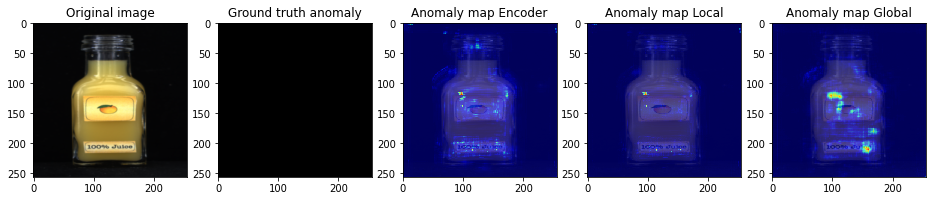

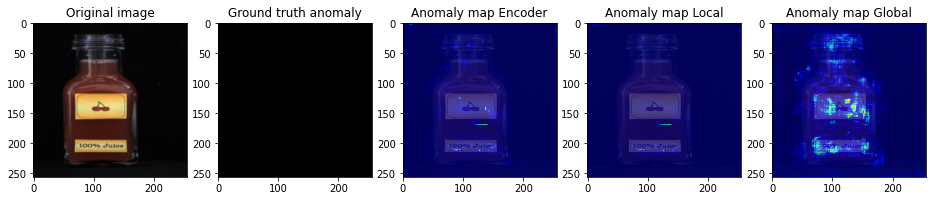

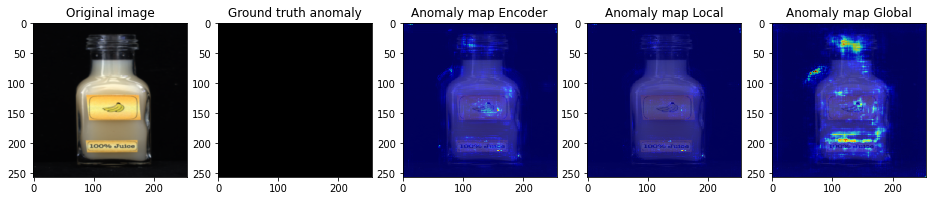

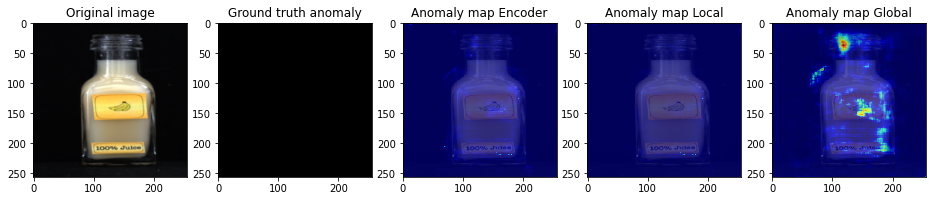

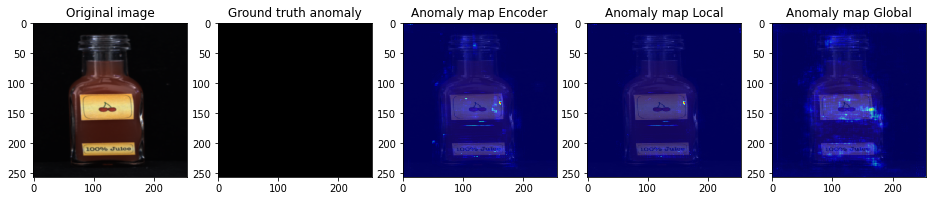

...

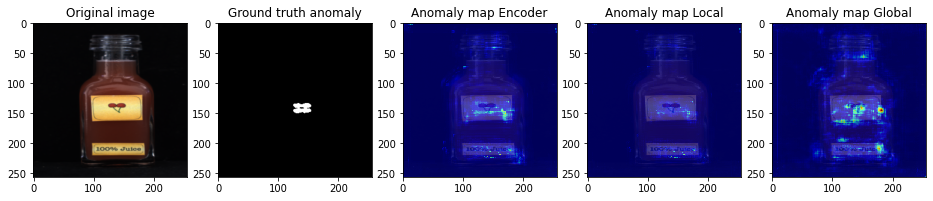

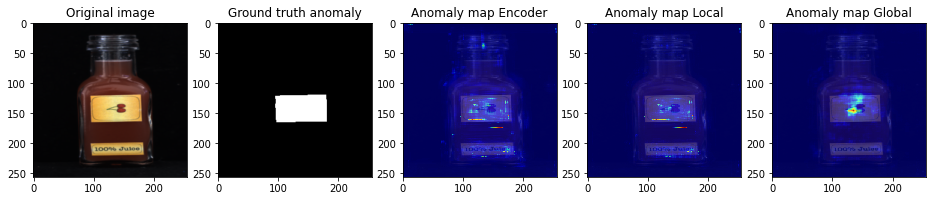

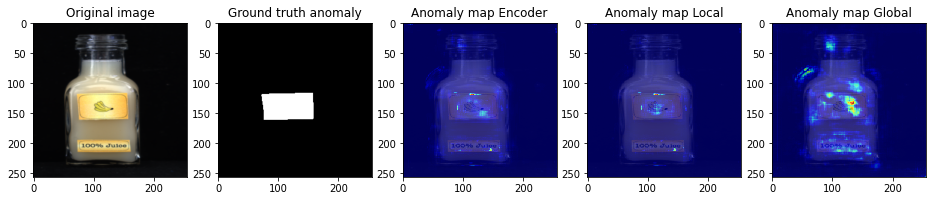

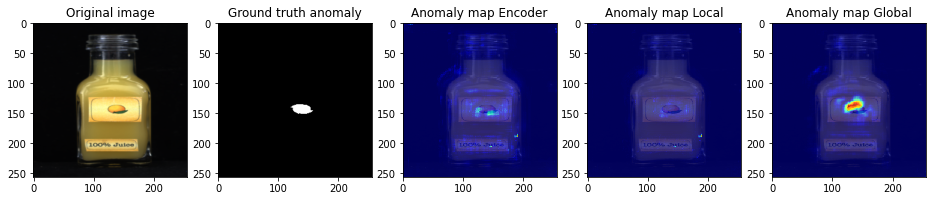

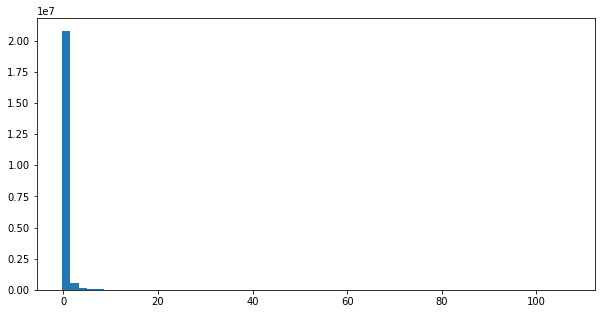

Threshold value is: -0.05734628811478615
F1 score:  0.04404545335168141


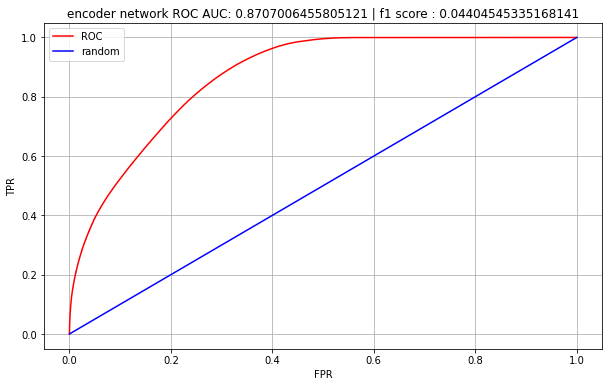

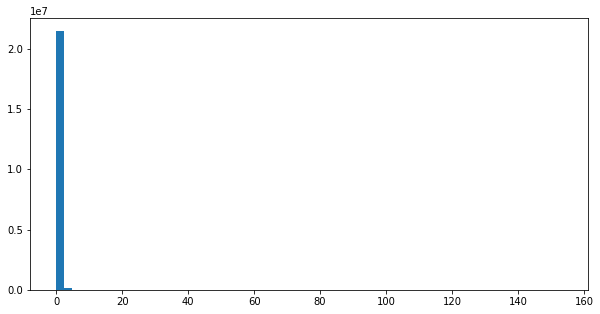

Threshold value is: -0.09872691333293915
F1 score:  0.03500413272897961


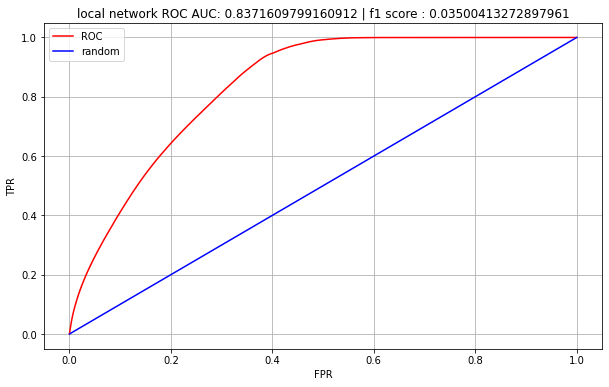

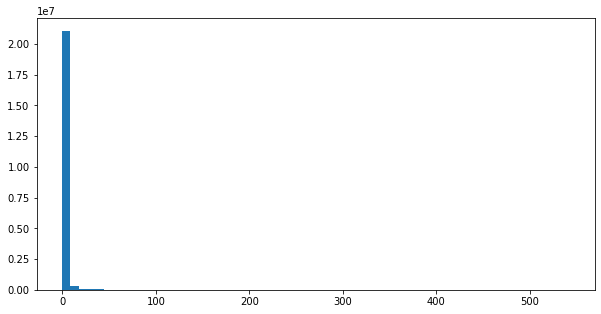

Threshold value is: 0.06514976918697357
F1 score:  0.04659867742037721


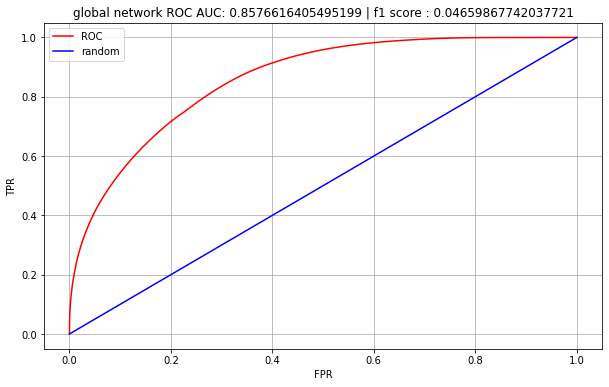

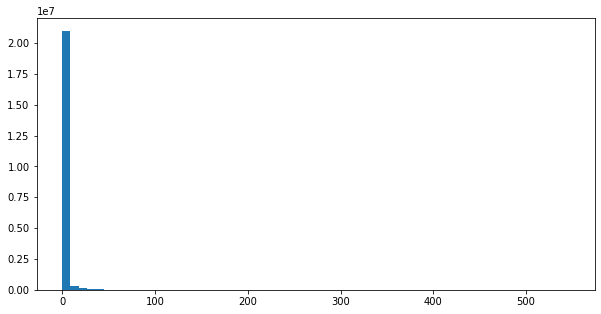

Threshold value is: 0.0480719655752182
F1 score:  0.04468777437279029


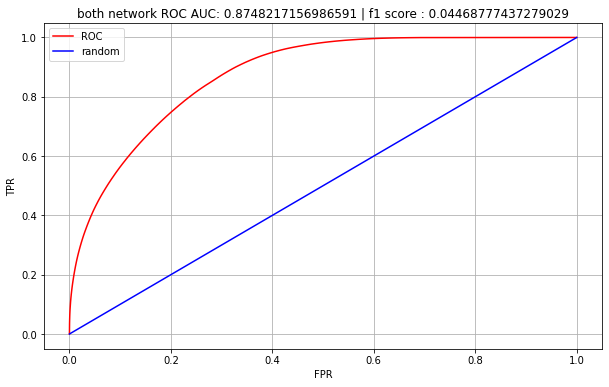

In [ ]:
# for mode in ['local', 'global', 'both']:
# for mode in ['local', 'global']:
# mode ='local'
mode = 'both'

# Load testing data
test_dataset = AnomalyDataset(
        root_dir=f"/content/drive/MyDrive/LOCO_AD/{target_dataset}",
        transform=transforms.Compose([
            transforms.Resize((256, 256)),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]),
        gt_transform=transforms.Compose([
            transforms.Resize((256, 256)),
            transforms.ToTensor()]),
        type='test')

test_dataloader = DataLoader(test_dataset, 
                     batch_size=1, 
                     shuffle=False)


# Build anomaly map
y_score_loc = np.array([])
y_score_enc = np.array([])
y_score_glo = np.array([])
y_true = np.array([])
img_gt = []
img_glo = []
img_sum = []
# params = {'students':{'max':0}}

test_iter = iter(test_dataloader)
test_size = len(test_dataset)

for i in range(test_size):
    batch = next(test_iter)
    inputs = batch['image'].to(device)
    gt = batch['gt'].cpu()

    score_map_enc = get_score_map_enc(inputs, localEncoder, globalEncoder, params_enc).cpu()
    cur_y_score_enc = rearrange(score_map_enc, 'b h w -> (b h w)').numpy()
    y_score_enc = np.concatenate((y_score_enc, cur_y_score_enc))  
    
    score_map_loc = get_score_map_loc(inputs, localEncoder, localRegressor, params_loc).cpu()
    cur_y_score_loc = rearrange(score_map_loc, 'b h w -> (b h w)').numpy()
    y_score_loc = np.concatenate((y_score_loc, cur_y_score_loc))
    
    score_map_glo = get_score_map_glo(inputs, globalEncoder, globalRegressor, params_glo).cpu()
    cur_y_score_glo = rearrange(score_map_glo, 'b h w -> (b h w)').numpy()
    y_score_glo = np.concatenate((y_score_glo, cur_y_score_glo))

    y_true = np.concatenate((y_true, rearrange(gt, 'b c h w -> (b c h w)').numpy()))

    unorm = transforms.Normalize((-1, -1, -1), (2, 2, 2)) # get back to original image
    img_in = rearrange(unorm(inputs).cpu(), 'b c h w -> b h w c')
    gt_in = rearrange(gt, 'b c h w -> b h w c')        

    b = 0
    visualize(img_in[b, :, :, :].squeeze(), 
              gt_in[b, :, :, :].squeeze(), 
              score_map_enc[b, :, :].squeeze(), params_enc['students'],
              score_map_loc[b, :, :].squeeze(), params_loc['students'],
              score_map_glo[b, : ,:].squeeze(), params_glo['students'],
              i, mode)
    if torch.max(gt) == 0:
        img_gt.append(0)
    else:
        img_gt.append(1)
    img_glo.append(np.max(cur_y_score_glo))
    img_sum.append(np.max(cur_y_score_glo+cur_y_score_loc))

for mode in ['encoder', 'local', 'global', 'both']:
    if mode == 'encoder':
        y_score = y_score_enc
    elif mode == 'local':
        y_score = y_score_loc
    elif mode == 'global':
        y_score = y_score_glo
    elif mode == 'both':
        y_score = y_score_glo + y_score_loc
    
    plt.figure(figsize=(10, 5))
    plt.hist(y_score, bins=60)
    plt.savefig(
        PATH + f"/results/{target_dataset}_{mode}_hist.png"
    )
    plt.show();

    # AUC ROC
    fpr, tpr, thresholds = roc_curve(np.around(y_true).astype(int), np.nan_to_num(y_score))
    optimal_idx = np.argmax(tpr - fpr)
    optimal_threshold = thresholds[optimal_idx]
    f1 = f1_score(y_true.astype(int), [1 if i > optimal_threshold else 0 for i in np.nan_to_num(y_score)])
    print("Threshold value is:", optimal_threshold)
    print("F1 score: ", f1)

    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, 'r', label="ROC")
    plt.plot(fpr, fpr, 'b', label="random")
    plt.title(f'{mode} network ROC AUC: {auc(fpr, tpr)} | f1 score : {f1}')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.legend()
    plt.grid()
    plt.savefig(
        PATH + f"/results/{target_dataset}_{mode}_roc.png"
    )
    plt.show();

Threshold value is: 19.724224
F1 score:  0.8597285067873303


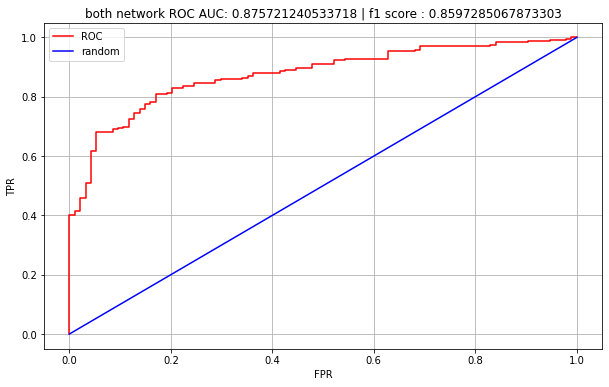

In [ ]:
fpr, tpr, thresholds = roc_curve(np.around(img_gt), np.nan_to_num(img_glo))
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
f1 = f1_score(img_gt, [1 if i > optimal_threshold else 0 for i in np.nan_to_num(img_glo)])
print("Threshold value is:", optimal_threshold)
print("F1 score: ", f1)

plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, 'r', label="ROC")
plt.plot(fpr, fpr, 'b', label="random")
plt.title(f'{mode} network ROC AUC: {auc(fpr, tpr)} | f1 score : {f1}')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.legend()
plt.grid()
plt.savefig(
    PATH + f"/results/image_{target_dataset}_global_roc.png"
)
plt.show();

Threshold value is: 35.60108
F1 score:  0.8169642857142857


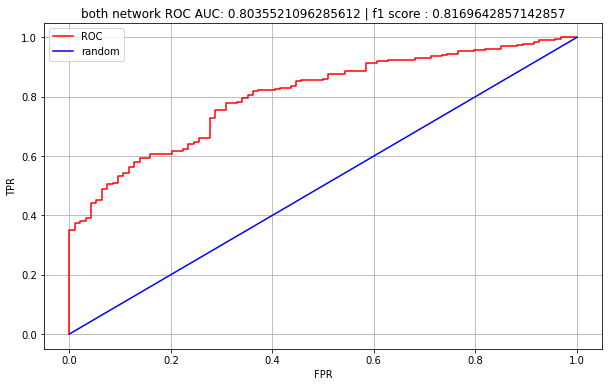

In [ ]:
fpr, tpr, thresholds = roc_curve(np.around(img_gt).astype(int), np.nan_to_num(img_sum))
optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
f1 = f1_score(img_gt, [1 if i > optimal_threshold else 0 for i in np.nan_to_num(img_sum)])
print("Threshold value is:", optimal_threshold)
print("F1 score: ", f1)

plt.figure(figsize=(10, 6))
plt.plot(fpr, tpr, 'r', label="ROC")
plt.plot(fpr, fpr, 'b', label="random")
plt.title(f'{mode} network ROC AUC: {auc(fpr, tpr)} | f1 score : {f1}')
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.legend()
plt.grid()
plt.savefig(
    PATH + f"/results/image_{target_dataset}_sum_roc.png"
)
plt.show();

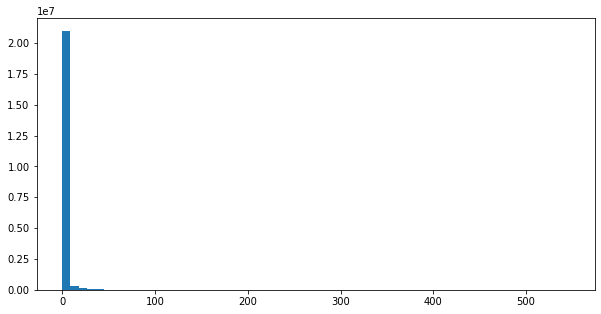

Threshold value is: 0.0480719655752182
F1 score:  0.04468777437279029


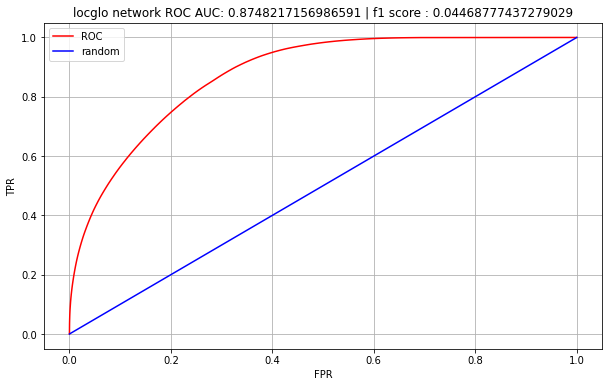

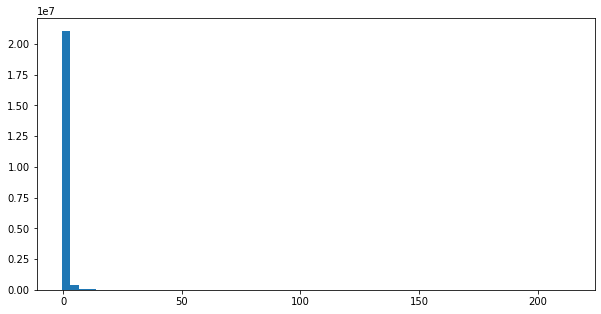

Threshold value is: -0.07431302964687347
F1 score:  0.045458086097694916


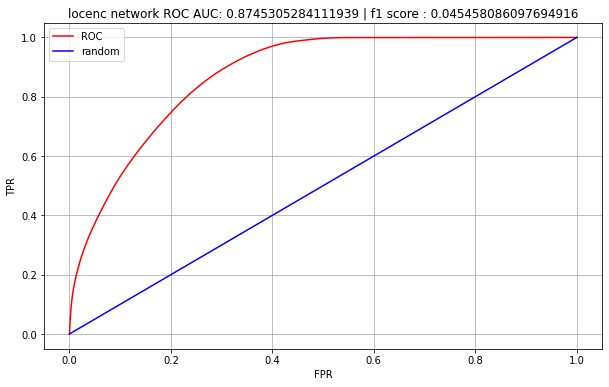

In [ ]:
for mode in ['locglo', 'locenc']:
    if mode == 'locglo':
        y_score = y_score_glo + y_score_loc
    elif mode == 'locenc':
        y_score = y_score_enc + y_score_loc
    
    plt.figure(figsize=(10, 5))
    plt.hist(y_score, bins=60)
    plt.savefig(
        PATH + f"/results/{target_dataset}_{mode}_hist.png"
    )
    plt.show();

    # AUC ROC
    fpr, tpr, thresholds = roc_curve(np.around(y_true).astype(int), np.nan_to_num(y_score))
    optimal_idx = np.argmax(tpr - fpr)
    optimal_threshold = thresholds[optimal_idx]
    f1 = f1_score(y_true.astype(int), [1 if i > optimal_threshold else 0 for i in np.nan_to_num(y_score)])
    print("Threshold value is:", optimal_threshold)
    print("F1 score: ", f1)

    plt.figure(figsize=(10, 6))
    plt.plot(fpr, tpr, 'r', label="ROC")
    plt.plot(fpr, fpr, 'b', label="random")
    plt.title(f'{mode} network ROC AUC: {auc(fpr, tpr)} | f1 score : {f1}')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.legend()
    plt.grid()
    plt.savefig(
        PATH + f"/results/{target_dataset}_{mode}_roc.png"
    )
    plt.show();